# App Brainstorm 1
- How does our classifier compare to Song Sleuth?
- What single species am I hearing?
    - Single pred for whole rec
- What multiple species am I hearing?
    - Top k preds for whole rec with cutoff
- What species at what times am I hearing?
    - Segment rec at multiple time granularities (~a few), single pred per segment, labeled with (start, stop)
- What xc recs are similar to this one?
    - ??? e.g. whole/segmented input rec? whole/segmented xc recs?

In [ ]:
from notebooks import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


The potoo.default_magic_magic extension is already loaded. To reload it, use:
  %reload_ext potoo.default_magic_magic


In [ ]:
# Default figsize for spectros
figsize(aspect=1/8);

In [ ]:
# TODO -> util

def is_species_prob(x):
    return isinstance(x, list) and len(x) == 2 and isinstance(x[0], float) and isinstance(x[1], str)

def style_preds_cell(x, species_true, cmap=mpl.cm.magma, cmap_min=.5, species_true_style='background: #336'):
    styles = []
    if is_species_prob(x):
        [p, species] = x
        styles.append('color: %s' % scale_color_cmap(cmap).palette(cmap_min + p * (1 - cmap_min)))
        if species == species_true:
            styles.append(species_true_style)
    return '; '.join(styles)

def style_preds(preds: DF):
    return (preds
        # TODO Works for df, make also work for df.T
        .style.apply(axis=1, func=lambda row: row.map(partial(style_preds_cell, species_true=row.species)))
        # .T.style.apply(axis=0, func=lambda row: row.map(partial(style_preds_cell, species_true=row.species)))
    )

In [ ]:
# Load species lists
species_us = com_names_to_species(*com_names['us'])
species_ca = com_names_to_species(*com_names['ca'])
species_dan170 = com_names_to_species(*com_names['dan170'])

In [ ]:
# Load model
search = Search.load_v0(
    # 'eval-na-ca/split_i=0,train=2688,test=672,classes=168', 'n_species=168,n_recs=1.0',
    # 'cls=logreg_ovr,solver=liblinear,C=0.05',
    'eval-na-dan170/split_i=0,train=2693,test=674,classes=170', 'n_species=170,n_recs=1.0',
    'cls=logreg_ovr,solver=liblinear,C=0.01,class_weight=balanced',
)
display(
    search,
    search.classifier_,
    len(search.classifier_.classes_),
)

Search(
  n_species=170,
  n_recs=1.0,
  classifier='cls: logreg_ovr,solver: liblinear,C: 0.01,class_weight: balanced',
  random_state=0,
  projection=Projection(
    features=Features(
      load=Load(channels=1, sample_rate=22050, sample_width_bit=16, cache_audio=True),
      sample_rate=22050,
      f_min=1000,
      f_bins=40,
      hop_length=256,
      frame_length=512,
      frame_window='hann',
      patch_length=4
    ),
    skm_fit_max_t=600000,
    k=500,
    variance_explained=0.99,
    do_pca=True,
    pca_whiten=True,
    standardize=False,
    normalize=False,
    agg_funs=['mean', 'std', 'max']
  )
)

LogisticRegression(C=0.01, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=-1, penalty='l2', random_state=0,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

170

In [ ]:
# HACK FIXME Why doesn't search.projection.skm_ exist after unpickle?
projection = Projection.load('peterson-v0-26bae1c', features=Features(load=Load()))
features = projection.features
load = features.load
search.projection = projection
# These both work...
joblib_loads(joblib_dumps(projection)).skm_
joblib_loads(joblib_dumps(search)).projection.skm_

[23:30:56.639] DEBUG  Projection.load
  path: /Users/danb/hack/bubo/features/data/models/projection/peterson-v0-26bae1c.pkl


In [ ]:
recs = load_user_recs(projection,
    # n=10,
)
display(
    df_summary(recs).T,
    recs[:10],
)

[23:30:56.764] DEBUG  Load.audio:in
  len(recs): 164
  len(recs) per dataset: {recordings: 164}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[#####################                                                                     ] | 23% Completed |  0.3s

[###############################################                                           ] | 52% Completed |  0.5s

[##########################################################################################] | 100% Completed |  0.7s

[23:30:57.450] DEBUG  Load.audio:out
  len(audio): 164


[23:30:58.852] WARN   Dropped 1 recs with duplicate audio_id


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,id,path,audio,audio_sha,feat
audio_id,,,,,,,,,,,,,,,
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,Bewick's Wren - BEWR,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2.wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot),Bewick's Wren - BEWR,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot),recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot).wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot): 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...


[23:30:58.909] DEBUG  Features.spectros:in
  len(recs): 163
  len(recs) per dataset: {recordings: 163}
  sum(duration_h): 3.29
  sum(samples_mb): 498.0
  sum(samples_n): 261204420
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[                                                                                          ] | 0% Completed |  0.3s

[                                                                                          ] | 0% Completed |  0.5s

[                                                                                          ] | 0% Completed |  0.6s

[                                                                                          ] | 0% Completed |  0.7s

[                                                                                          ] | 0% Completed |  0.8s

[                                                                                          ] | 0% Completed |  0.9s

[                                                                                          ] | 0% Completed |  1.0s

[                                                                                          ] | 0% Completed |  1.2s

[                                                                                          ] | 0% Completed |  1.3s

[                                                                                          ] | 0% Completed |  1.5s

[                                                                                          ] | 0% Completed |  1.6s

[                                                                                          ] | 0% Completed |  1.8s

[####                                                                                      ] | 4% Completed |  1.9s

[#####                                                                                     ] | 6% Completed |  2.0s

[#####                                                                                     ] | 6% Completed |  2.1s

[#####                                                                                     ] | 6% Completed |  2.2s

[########                                                                                  ] | 9% Completed |  2.3s

[##########                                                                                ] | 12% Completed |  2.4s

[##########                                                                                ] | 12% Completed |  2.6s

[#############                                                                             ] | 15% Completed |  2.7s

[#############                                                                             ] | 15% Completed |  2.9s

[################                                                                          ] | 18% Completed |  3.0s

[################                                                                          ] | 18% Completed |  3.1s

[###################                                                                       ] | 21% Completed |  3.2s

[########################                                                                  ] | 27% Completed |  3.4s

[########################                                                                  ] | 27% Completed |  3.5s

[###########################                                                               ] | 30% Completed |  3.6s

[################################                                                          ] | 36% Completed |  3.7s

[###################################                                                       ] | 39% Completed |  3.9s

[######################################                                                    ] | 42% Completed |  4.0s

[######################################                                                    ] | 42% Completed |  4.1s

[######################################                                                    ] | 42% Completed |  4.2s

[######################################                                                    ] | 42% Completed |  4.4s

[######################################                                                    ] | 42% Completed |  4.5s

[########################################                                                  ] | 45% Completed |  4.7s

[########################################                                                  ] | 45% Completed |  4.8s

[##############################################                                            ] | 51% Completed |  4.9s

[##############################################                                            ] | 51% Completed |  5.0s

[##############################################                                            ] | 51% Completed |  5.2s

[##############################################                                            ] | 51% Completed |  5.4s

[#################################################                                         ] | 54% Completed |  5.5s

[#################################################                                         ] | 54% Completed |  5.6s

[#################################################                                         ] | 54% Completed |  5.9s

[###################################################                                       ] | 57% Completed |  6.0s

[######################################################                                    ] | 60% Completed |  6.1s

[######################################################                                    ] | 60% Completed |  6.2s

[######################################################                                    ] | 60% Completed |  6.3s

[######################################################                                    ] | 60% Completed |  6.4s

[######################################################                                    ] | 60% Completed |  6.5s

[######################################################                                    ] | 60% Completed |  6.8s

[######################################################                                    ] | 60% Completed |  6.9s

[############################################################                              ] | 66% Completed |  7.1s

[############################################################                              ] | 66% Completed |  7.3s

[############################################################                              ] | 66% Completed |  7.4s

[############################################################                              ] | 66% Completed |  7.6s

[############################################################                              ] | 66% Completed |  7.7s

[############################################################                              ] | 66% Completed |  7.8s

[############################################################                              ] | 66% Completed |  7.9s

[############################################################                              ] | 66% Completed |  8.1s

[##############################################################                            ] | 69% Completed |  8.2s

[##############################################################                            ] | 69% Completed |  8.3s

[##############################################################                            ] | 69% Completed |  8.4s

[##############################################################                            ] | 69% Completed |  8.7s

[#################################################################                         ] | 72% Completed |  8.9s

[####################################################################                      ] | 75% Completed |  9.0s

[####################################################################                      ] | 75% Completed |  9.2s

[####################################################################                      ] | 75% Completed |  9.3s

[####################################################################                      ] | 75% Completed |  9.5s

[####################################################################                      ] | 75% Completed |  9.6s

[####################################################################                      ] | 75% Completed |  9.7s

[######################################################################                    ] | 78% Completed |  9.8s

[######################################################################                    ] | 78% Completed |  9.9s

[######################################################################                    ] | 78% Completed | 10.1s

[######################################################################                    ] | 78% Completed | 10.2s

[#########################################################################                 ] | 81% Completed | 10.3s

[############################################################################              ] | 84% Completed | 10.4s

[############################################################################              ] | 84% Completed | 10.5s

[############################################################################              ] | 84% Completed | 10.6s

[#################################################################################         ] | 90% Completed | 10.7s

[####################################################################################      ] | 93% Completed | 10.8s

[####################################################################################      ] | 93% Completed | 10.9s

[####################################################################################      ] | 93% Completed | 11.0s

[####################################################################################      ] | 93% Completed | 11.1s

[####################################################################################      ] | 93% Completed | 11.3s

[#######################################################################################   ] | 96% Completed | 11.4s

[#######################################################################################   ] | 96% Completed | 11.5s

[#######################################################################################   ] | 96% Completed | 11.6s

[#######################################################################################   ] | 96% Completed | 11.7s

[#######################################################################################   ] | 96% Completed | 11.8s

[#######################################################################################   ] | 96% Completed | 11.9s

[##########################################################################################] | 100% Completed | 12.0s

[23:31:11.023] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 1020094]


,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
audio_id,object,11410,163,163,163.0,NaN,NaN,20160709-1e8c,20160910-3543,20171007-a787,20180513-1a88,20180805-60c3
recorded_at,datetime64[ns],1304,163,163,163.0,NaN,NaN,2016-07-09 18:38:51,2016-09-10 21:27:02,2017-10-07 15:18:55,2018-05-13 17:35:14,2018-08-05 15:57:16
dataset,object,10921,163,163,1.0,NaN,NaN,recordings,recordings,recordings,recordings,recordings
species,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
species_com_name,object,10933,163,163,35.0,NaN,NaN,American Bittern,Red-tailed Hawk,Unknown,Unknown,Wilson's Warbler
species_query,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
duration_s,float64,1304,163,163,158.0,NaN,NaN,2.75,19.1,48.8,90.8,691
samples_mb,float64,1304,163,163,158.0,NaN,NaN,0.115,0.804,2.05,3.82,29
samples_n,int64,1304,163,163,158.0,NaN,NaN,60544,421573,1076243,2002707,15229220


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,id,path,audio,audio_sha,feat,spectro
audio_id,,,,,,,,,,,,,,,,
20160709-1e8c,2016-07-09 19:04:03,recordings,CALT,California Towhee,CALT,43.2,1.820,951746,CALT cal towhee,California Towhee - CALT,recordings/CALT cal towhee,recordings/CALT cal towhee.wav,"box(unbox=recordings/CALT cal towhee: 1 channels, 16 bit, sampled @ 22.05 kHz, 43.163s long)",1e8c9cfe8f48560aa30173bb9f20aee30e7ecd71,[ 2.035e-03 6.529e-02 2.609e-01 -8.920e-02 7.727e-02 2.055e-01 2.770e-02 -5.686e-02 4.625e-01 -4.459e-02\n -2.317e-01 1.583e-01 -7.546e-03 -1.656e-01 2.748e-02 -1.4...,
20160709-228d,2016-07-09 20:51:51,recordings,RTHA,Red-tailed Hawk,RTHA,42.1,1.770,928934,"RTHA red tailed hawk, noise",Red-tailed Hawk - RTHA,"recordings/RTHA red tailed hawk, noise","recordings/RTHA red tailed hawk, noise.wav","box(unbox=recordings/RTHA red tailed hawk, noise: 1 channels, 16 bit, sampled @ 22.05 kHz, 42.129s long)",228d2414340927d1c8193963959bb82a6681e6db,[ 1.452e-01 -3.292e-02 6.948e-01 -2.057e-02 -1.251e-02 -2.576e-02 4.741e-02 -4.145e-01 1.621e-01 -1.482e-01\n -1.505e-01 1.070e-01 -3.720e-02 -8.035e-02 -5.857e-03 1.3...,
20160709-4bb7,2016-07-09 19:57:52,recordings,_UNK,Unknown,_UNK,59.9,2.520,1320202,Recording 0019,Unknown - _UNK,recordings/Recording 0019,recordings/Recording 0019.wav,"box(unbox=recordings/Recording 0019: 1 channels, 16 bit, sampled @ 22.05 kHz, 59.873s long)",4bb7924a5092f24d2fede40c339479b1befb6ac0,[ 4.733e-02 2.485e-02 1.041e-01 -2.679e-02 2.001e-02 3.011e-03 9.353e-02 -1.986e-02 9.155e-02 -9.730e-02\n -2.053e-01 3.033e-01 -8.698e-03 -9.605e-02 9.715e-02 1.5...,
20160709-4e73,2016-07-09 19:07:43,recordings,WCSP,White-crowned Sparrow,WCSP,21.9,0.923,483910,WCSP white crowned,White-crowned Sparrow - WCSP,recordings/WCSP white crowned,recordings/WCSP white crowned.wav,"box(unbox=recordings/WCSP white crowned: 1 channels, 16 bit, sampled @ 22.05 kHz, 21.946s long)",4e73e2c74b271647b5406c5784b8af1fd609b8eb,[ 2.455e-02 -1.062e-02 9.811e-01 -9.299e-02 4.945e-02 -5.597e-02 5.669e-02 -2.279e-01 4.159e-01 -7.791e-02\n -1.896e-01 1.582e-01 -4.445e-02 -9.104e-02 6.175e-02 -1.1...,
20160709-59d3,2016-07-09 18:53:03,recordings,RTHA,Red-tailed Hawk,RTHA,30.6,1.290,674360,RTHA red tailed hawk,Red-tailed Hawk - RTHA,recordings/RTHA red tailed hawk,recordings/RTHA red tailed hawk.wav,"box(unbox=recordings/RTHA red tailed hawk: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.583s long)",59d360c416f841fdc19213c1943c73b39992e241,[ 2.229e-02 -1.745e-02 7.496e-01 -5.046e-02 -3.577e-02 -4.409e-02 2.941e-04 -2.590e-01 2.597e-01 2.174e-02\n -1.398e-01 -4.891e-02 -5.807e-03 -9.787e-02 -1.195e-01 -1.8...,
20160709-795e,2016-07-09 20:34:26,recordings,_UNK,Unknown,_UNK,71.2,2.990,1569411,unknown sparrow (song?),Unknown - _UNK,recordings/unknown sparrow (song?),recordings/unknown sparrow (song?).wav,"box(unbox=recordings/unknown sparrow (song?): 1 channels, 16 bit, sampled @ 22.05 kHz, 71.175s long)",795e65fdd0566f69ddfaa13bae28c5e6fde0d3f6,[ 1.549e-01 -4.838e-02 1.737e-01 2.306e-02 3.237e-04 -4.025e-02 1.242e-01 -8.359e-02 2.388e-01 -9.303e-02\n -2.223e-01 2.008e-02 -1.347e-01 -4.654e-02 -5.248e-02 3.6...,
20160709-81dc,2016-07-09 20:59:19,recordings,HAWO,Hairy Woodpecker,HAWO,59.3,2.490,1307828,HAWO hairy woodpecker (2),Hairy Woodpecker - HAWO,recordings/HAWO hairy woodpecker (2),recordings/HAWO hairy woodpecker (2).wav,"box(unbox=recordings/HAWO hairy woodpecker (2): 1 channels, 16 bit, sampled @ 22.05 kHz, 59.312s long)",81dc45758f7932931a1072df74422793bb083cda,[ 6.210e-02 -3.008e-02 9.021e-03 -5.638e-02 1.596e-02 -4.143e-02 6.790e-02 -2.643e-02 1.448e-01 -8.180e-02\n -9.243e-02 1.103e-01 -3.034e-02 -3.102e-02 6.833e-02 -1.6...,
20160709-8c26,2016-07-09 19:51:42,recordings,_UNK,Unknown,_UNK,72.1,3.030,1589856,Recording 0018,Unknown - _UNK,recordings/Recording 0018,recordings/Recording 0018.wav,"box(unbox=recordings/Recording 0018: 1 channels, 16 bit, sam

In [ ]:
# Compute bulk preds
abbrev_str = lambda s, n: s if len(s) < 80 else '%s...%s' % (s[:40], s[-40:])
top_k = 10
preds = (recs
    # [:10]
    [['recorded_at', 'basename', 'duration_s', 'species_com_name', 'species', 'audio', 'spectro', 'feat']]
    .assign(
        # in_dan170=lambda df: df.species.isin(species_dan170),
        # in_ca=lambda df: df.species.isin(species_ca),
        # in_us=lambda df: df.species.isin(species_us),
        coverage_error=lambda df: SearchEvals(search=search, recs=df).coverage_errors(),
    )
    .pipe(lambda df: df.join(how='left', other=(df
        .pipe(search.species_probs)
        .drop(columns=['species_true'])
        .applymap(lambda x: x if not is_species_prob(x) else [round_sig(x[0], 2), x[1]])
        .T[:1 + top_k].T
    )))
    .drop(columns=['feat'])
    .pipe(df_reorder_cols, last=['audio', 'spectro'])
    .sort_values(['in_model', 'species', 'coverage_error'], ascending=[False, True, True])
)
display(
    style_preds(preds
        .assign(basename=lambda df: df.basename.map(lambda s: abbrev_str(s, 80)))
        .drop(columns=['audio', 'spectro'])
    ),
)

,recorded_at,basename,duration_s,species_com_name,species,coverage_error,in_model,0,1,2,3,4,5,6,7,8,9
audio_id,,,,,,,,,,,,,,,,,
20171007-602c,2017-10-07 15:20:39,BEWR Bewicks Wren (Coyote Hills parking lot),46.5,Bewick's Wren,BEWR,4,True,"[0.31, 'BOCH']","[0.066, 'RWBL']","[0.042, 'YRWA']","[0.034, 'BEWR']","[0.033, 'HOWR']","[0.027, 'CARW']","[0.025, 'LASP']","[0.022, 'HAWO']","[0.022, 'BCTI']","[0.018, 'STJA']"
20180805-60c3,2018-08-05 15:57:16,BEWR - vollmer peak,30.2,Bewick's Wren,BEWR,12,True,"[0.11, 'OATI']","[0.057, 'BTPI']","[0.056, 'GCWA']","[0.05, 'BGGN']","[0.043, 'HUVI']","[0.039, 'RCSP']","[0.031, 'CARW']","[0.031, 'WEKI']","[0.029, 'LISP']","[0.029, 'NOMO']"
20171007-c6f4,2017-10-07 15:18:04,BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,30.3,Bewick's Wren,BEWR,98,True,"[0.15, 'OATI']","[0.053, 'RCKI']","[0.049, 'LASP']","[0.043, 'DOWO']","[0.042, 'MOCH']","[0.038, 'VATH']","[0.033, 'SSHA']","[0.026, 'PISI']","[0.025, 'MAWA']","[0.022, 'RBNU']"
20160910-a886,2016-09-10 23:41:36,"BLPH black phoebe, sitting and catching",83.3,Black Phoebe,BLPH,2,True,"[0.13, 'RWBL']","[0.073, 'BLPH']","[0.059, 'WEWP']","[0.057, 'CERW']","[0.054, 'AMCR']","[0.052, 'MONQ']","[0.05, 'BTNW']","[0.041, 'FOSP']","[0.036, 'HEWA']","[0.036, 'BTPI']"
20160910-be46,2016-09-10 23:39:35,"BLPH black phoebe, chirps, noise",32.9,Black Phoebe,BLPH,6,True,"[0.093, 'GTGR']","[0.084, 'KILL']","[0.048, 'WEWP']","[0.043, 'HOSP']","[0.042, 'GRHE']","[0.042, 'BLPH']","[0.039, 'CORA']","[0.032, 'CAQU']","[0.028, 'GBHE']","[0.026, 'CERW']"
20180428-087d,2018-04-28 15:29:07,BRCR brown creeper- fault count,31.2,Brown Creeper,BRCR,60,True,"[0.2, 'MONQ']","[0.13, 'EUCD']","[0.084, 'RODO']","[0.07, 'LEBI']","[0.07, 'DCCO']","[0.065, 'MODO']","[0.04, 'GHOW']","[0.037, 'COGR']","[0.028, 'HOOR']","[0.021, 'CLNU']"
20180429-09b4,2018-04-29 18:11:40,BTYW black throated gray- kings rd,59.5,Black-throated Gray Warbler,BTYW,81,True,"[0.18, 'GCWA']","[0.11, 'RBSA']","[0.072, 'MODO']","[0.069, 'RWBL']","[0.059, 'MAWR']","[0.038, 'CERW']","[0.034, 'HOOR']","[0.029, 'GCSP']","[0.027, 'MONQ']","[0.026, 'BHCO']"
20180623-6ecc,2018-06-23 02:35:29,BUSH bush tit - mitchell canyon poorwill walk,47.8,Bushtit,BUSH,18,True,"[0.1, 'CACH']","[0.056, 'AMRE']","[0.052, 'SOGR']","[0.045, 'MAWR']","[0.044, 'STJA']","[0.035, 'CONI']","[0.032, 'GHOW']","[0.029, 'BEWR']","[0.026, 'RBNU']","[0.025, 'CORA']"
20160709-1e8c,2016-07-09 19:04:03,CALT cal towhee,43.2,California Towhee,CALT,35,True,"[0.096, 'BTNW']","[0.053, 'RCKI']","[0.053, 'DEJU']","[0.05, 'YRWA']","[0.042, 'OCWA']","[0.033, 'MAWR']","[0.029, 'HOSP']","[0.029, 'SOGR']","[0.028, 'WREN']","[0.027, 'HAWO']"


20180805-60c3  2018-08-05T15:57:16  BEWR  30.2s  BEWR - vollmer peak


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,OATI,BTPI,GCWA,BGGN,HUVI,RCSP,CARW,WEKI,LISP,NOMO,BARS,BEWR,RWBL,HOSP,CANT
p,0.105,0.0571,0.0558,0.0504,0.0428,0.0388,0.0313,0.0308,0.0292,0.029,0.0245,0.0213,0.0198,0.0197,0.0196


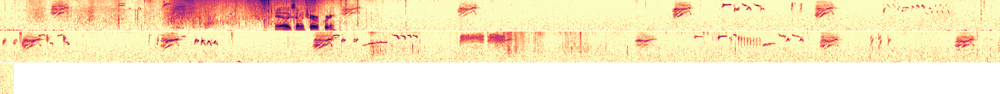

recordings/BEWR - vollmer peak: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.232s long


20180724-d53b  2018-07-24T20:08:39  _UNK  690.7s  q- pull this apart- very long and noisy- lots of western tanager M-F pair at the end- bubbly metallic- reflection lake


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,HOOR,CACW,CORA,MAWR,MOCH,COGR,TUTI,RWBL,BHCO,RBNU,HOSP,WOTH,RTHA,RODO,LEBI
p,0.222,0.103,0.0641,0.0636,0.0574,0.0516,0.0419,0.0396,0.0339,0.0248,0.0207,0.0193,0.0141,0.0135,0.0121


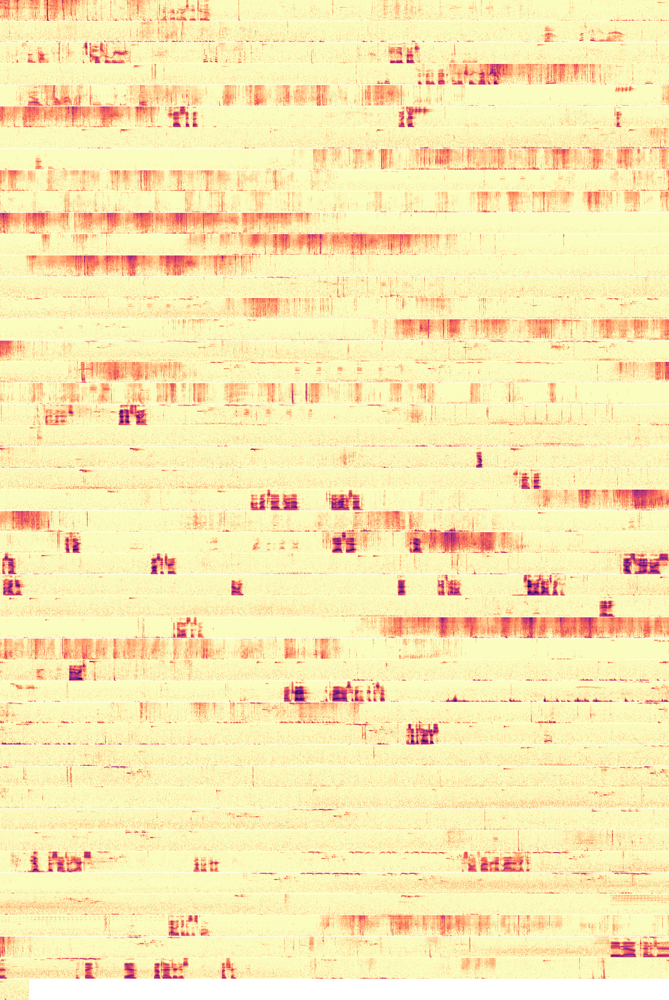

recordings/q- pull this apart- very long and noisy- lots of western tanager M-F pair at the end- bubbly metallic- reflection lake: 1 channels, 16 bit, sampled @ 22.05 kHz, 690.668s long


20180724-3fba  2018-07-24T19:08:02  _UNK  55.5s  q- what is this -wood pewee- flycatcher or vireo -at beginning- reflection lake lassen


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,WEWP,SOGR,CONI,GCSP,COYE,WEKI,STJA,BTBW,HOSP,CACW,PYNU,CORA,BTYW,COPO,SOSP
p,0.65,0.0658,0.0298,0.0155,0.0154,0.0131,0.0124,0.0119,0.011,0.0109,0.00891,0.00858,0.00749,0.00716,0.00655


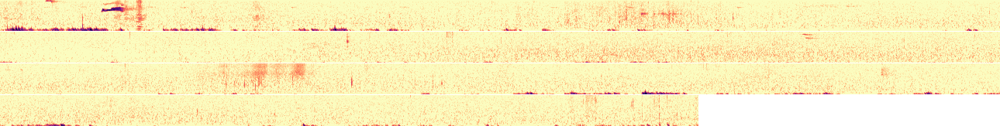

recordings/q- what is this -wood pewee- flycatcher or vireo -at beginning- reflection lake lassen: 1 channels, 16 bit, sampled @ 22.05 kHz, 55.480s long


20180724-a691  2018-07-24T16:48:32  _UNK  24.2s  q- what warbler is this- seeing hermit and orange crowned- manzanita lake lassen


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,WIWR,COGR,NUWO,RBSA,RCKI,COYE,RBNU,MOCH,RODO,LEBI,BTNW,HEWA,YRWA,SSHA,DOWO
p,0.266,0.192,0.159,0.0406,0.0401,0.0279,0.0195,0.0145,0.0145,0.0142,0.0118,0.0115,0.0113,0.0106,0.00982


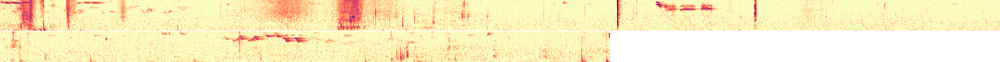

recordings/q- what warbler is this- seeing hermit and orange crowned- manzanita lake lassen: 1 channels, 16 bit, sampled @ 22.05 kHz, 24.153s long


20180723-df3a  2018-07-23T00:37:12  _UNK  38.5s  stupid chipmunk- manzanita lake lassen


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,HOSP,AMKE,CLSW,CARW,SWTH,BHGR,NOMO,BESP,MAWR,WEKI,SUTA,CONI,HUVI,WTSW,ANHU
p,0.218,0.0864,0.0726,0.0673,0.0387,0.0367,0.0355,0.0352,0.025,0.0224,0.0214,0.0194,0.0178,0.017,0.0165


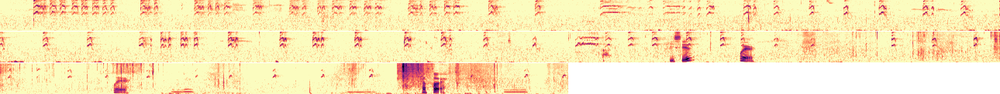

recordings/stupid chipmunk- manzanita lake lassen: 1 channels, 16 bit, sampled @ 22.05 kHz, 38.526s long


20180723-4351  2018-07-23T00:33:25  _UNK  45.1s  q- what is this 1-5khz call- mazanita lake lassen


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,LEBI,CACH,SOGR,COPO,CLSW,PUMA,WEWP,WOTH,NOHA,MAWR,STJA,PHAI,WESO,SWTH,WEKI
p,0.169,0.136,0.111,0.0501,0.0435,0.0276,0.0255,0.024,0.0209,0.0207,0.0206,0.0191,0.0172,0.016,0.0145


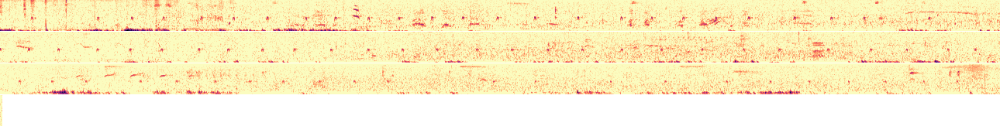

recordings/q- what is this 1-5khz call- mazanita lake lassen: 1 channels, 16 bit, sampled @ 22.05 kHz, 45.053s long


20180722-d382  2018-07-22T23:47:32  _UNK  116.8s  spotted sandpiper- manzanita lake lassen


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,SEWR,CAQU,WCSP,WREN,CORA,MOCH,CONI,BUOW,LEBI,HOSP,CLSW,RWBL,WTSW,MAWR,CANW
p,0.554,0.211,0.0488,0.0362,0.0181,0.015,0.0117,0.0112,0.0089,0.00836,0.00813,0.00775,0.00679,0.00511,0.00316


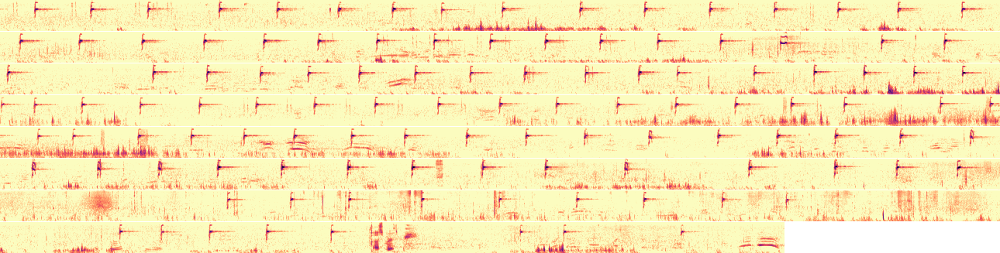

recordings/spotted sandpiper- manzanita lake lassen: 1 channels, 16 bit, sampled @ 22.05 kHz, 116.764s long


20180715-69e5  2018-07-15T15:27:01  _UNK  113.3s  pull this apart- SWTH weep call- SPTO- others


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,RCKI,WOTH,OSFL,PUFI,WIWA,WAVI,HETH,CONI,AMRO,YRWA,WCSP,FOSP,COYE,DOWO,BLPW
p,0.35,0.0888,0.0619,0.0569,0.0225,0.0205,0.0197,0.0183,0.0166,0.0159,0.0144,0.0144,0.012,0.0109,0.0103


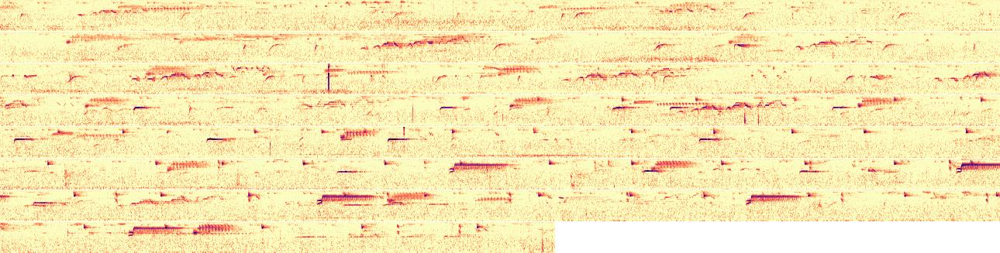

recordings/pull this apart- SWTH weep call- SPTO- others: 1 channels, 16 bit, sampled @ 22.05 kHz, 113.327s long


20180702-f62b  2018-07-02T19:24:12  _UNK  63.4s  SOSP-WIWA-BEKI - anza lake- tilden park


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,BEWR,LASP,EUST,BRCR,BTPI,BHCO,ACWO,CALT,EUCD,WIWR,GRHE,HEWA,CEDW,HOFI,LEBI
p,0.751,0.0864,0.0137,0.0121,0.0118,0.00769,0.0075,0.00683,0.00603,0.00569,0.00555,0.00506,0.0046,0.00404,0.00394


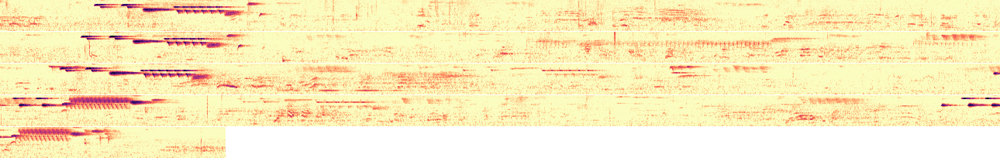

recordings/SOSP-WIWA-BEKI - anza lake- tilden park: 1 channels, 16 bit, sampled @ 22.05 kHz, 63.396s long


20180702-ce93  2018-07-02T19:03:59  _UNK  223.2s  good test case- mixed swaisons thrush- sosp- wiwa- chestnut chickadee- human noise - anza lake- tilden park


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,BTPI,MONQ,RWBL,HOOR,DCCO,CORA,BCTI,CARW,BBMA,LEBI,EUST,EUCD,COHA,BHCO,RODO
p,0.14,0.111,0.102,0.0734,0.0628,0.0342,0.033,0.0326,0.0325,0.0315,0.0299,0.0251,0.0248,0.0245,0.014


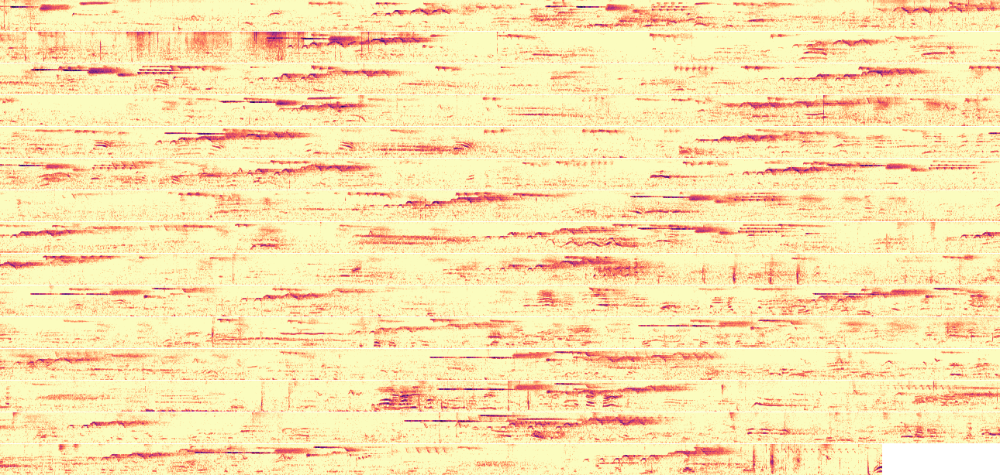

recordings/good test case- mixed swaisons thrush- sosp- wiwa- chestnut chickadee- human noise - anza lake- tilden park: 1 channels, 16 bit, sampled @ 22.05 kHz, 223.231s long


20180701-3caa  2018-07-01T16:01:29  _UNK  30.3s  q- what is this -not pac slope- big sur


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,HEWA,RODO,COGR,MAWR,BRCR,RWBL,BTPI,RCKI,RUHU,CACH,BHCO,BTNW,MONQ,GCWA,GHOW
p,0.224,0.0929,0.061,0.0425,0.0399,0.0355,0.0316,0.0245,0.0239,0.02,0.0182,0.0145,0.0141,0.0137,0.012


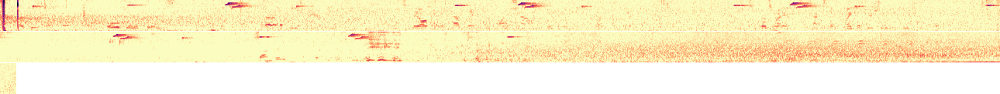

recordings/q- what is this -not pac slope- big sur: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.267s long


20180630-f027  2018-06-30T21:31:14  _UNK  50.9s  q- what is this- big sur


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,RWBL,SOGR,LEBI,HEWA,GCWA,HOSP,MAWR,BTNW,WCSP,RBSA,LISP,SPTO,CLNU,DEJU,MONQ
p,0.121,0.0896,0.0672,0.063,0.0579,0.0491,0.0406,0.0347,0.0203,0.0186,0.0178,0.0177,0.016,0.015,0.0149


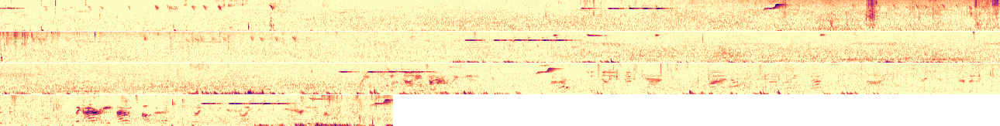

recordings/q- what is this- big sur: 1 channels, 16 bit, sampled @ 22.05 kHz, 50.901s long


20180623-5b38  2018-06-23T04:51:26  COPO  140.4s  COPO - mitchell canyon


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,DCCO,BTPI,RODO,RUHU,RWBL,SEWR,CONI,EUCD,MONQ,GBHE,GHOW,SOGR,LEBI,MAWR,CARW
p,0.294,0.156,0.133,0.0692,0.0301,0.0298,0.0282,0.027,0.0262,0.0198,0.0174,0.0145,0.0125,0.0114,0.0112


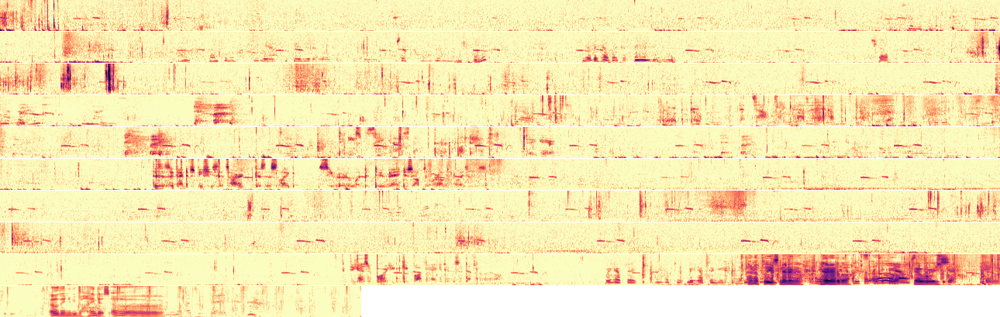

recordings/COPO - mitchell canyon: 1 channels, 16 bit, sampled @ 22.05 kHz, 140.432s long


20180623-6ecc  2018-06-23T02:35:29  BUSH  47.8s  BUSH bush tit - mitchell canyon poorwill walk


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,CACH,AMRE,SOGR,MAWR,STJA,CONI,GHOW,BEWR,RBNU,CORA,BUOR,BLPW,BTNW,MODO,MOCH
p,0.102,0.056,0.0522,0.0453,0.0443,0.0346,0.0325,0.0293,0.0263,0.0252,0.0241,0.0232,0.0205,0.0184,0.0177


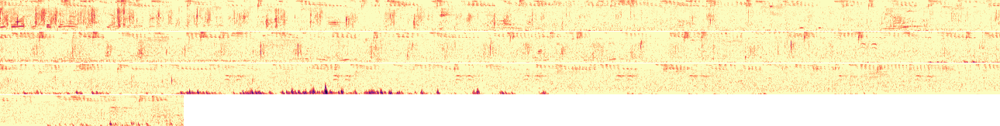

recordings/BUSH bush tit - mitchell canyon poorwill walk: 1 channels, 16 bit, sampled @ 22.05 kHz, 47.768s long


20180610-d310  2018-06-10T17:18:08  FOSP  10.2s  FOSP fox sparrow- sardine lake


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,HEWA,BLGR,HUVI,BESP,FOSP,OSFL,BTPI,RODO,YRWA,HOFI,WCSP,WTSW,CLSW,CALT,CANT
p,0.136,0.0973,0.0905,0.0457,0.0365,0.0303,0.0258,0.0232,0.0203,0.0192,0.0175,0.0164,0.0162,0.0161,0.0156


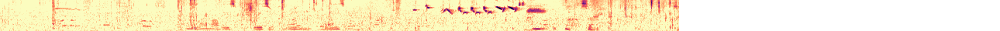

recordings/FOSP fox sparrow- sardine lake: 1 channels, 16 bit, sampled @ 22.05 kHz, 10.184s long


20180608-f914  2018-06-08T16:51:12  _UNK  46.6s  barn swallow- swallow sp- MAWR- yellow headed blackbird- sierraville


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,BARS,EUST,BHCO,MOUQ,CATH,CLSW,LASP,HOOR,MONQ,RWBL,GRCA,CAVI,MAWR,WBNU,HOSP
p,0.103,0.0923,0.086,0.0798,0.0656,0.0587,0.0491,0.0372,0.0363,0.0266,0.0262,0.019,0.0175,0.0154,0.0144


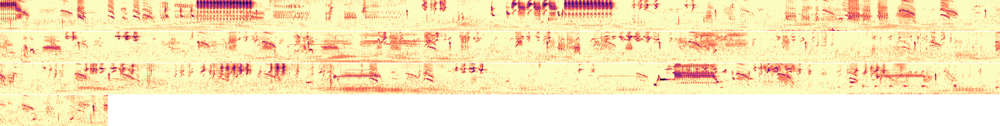

recordings/barn swallow- swallow sp- MAWR- yellow headed blackbird- sierraville: 1 channels, 16 bit, sampled @ 22.05 kHz, 46.630s long


20180608-09ec  2018-06-08T16:45:45  _UNK  39.5s  MAWR- yellow headed blackbird- sierravile


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,MAWR,PUMA,NOMO,MOUQ,MONQ,BUOR,SCQU,BESP,WEBL,SPTO,STJA,SOGR,HOOR,RTHA,HOSP
p,0.468,0.0987,0.0758,0.0683,0.0412,0.0383,0.0277,0.0271,0.0206,0.0105,0.0103,0.00962,0.00826,0.00725,0.00677


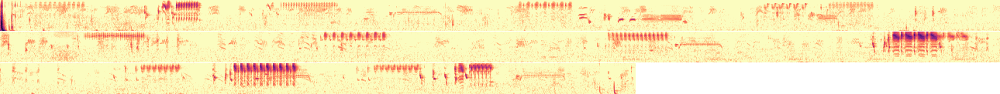

recordings/MAWR- yellow headed blackbird- sierravile: 1 channels, 16 bit, sampled @ 22.05 kHz, 39.539s long


20180608-d84f  2018-06-08T16:43:43  MAWR  99.8s  MAWR marsh wren- yellow headed blackbird- blackbird sp- swallow sp- sierraville


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,LEBI,MONQ,CATH,MAWR,RWBL,BUOR,CLSW,HOSP,NOMO,GRHE,BEWR,WEBL,NOCA,SPTO,SEWR
p,0.157,0.143,0.0881,0.0832,0.0693,0.0655,0.0641,0.0464,0.0445,0.019,0.0145,0.0144,0.0123,0.0123,0.0113


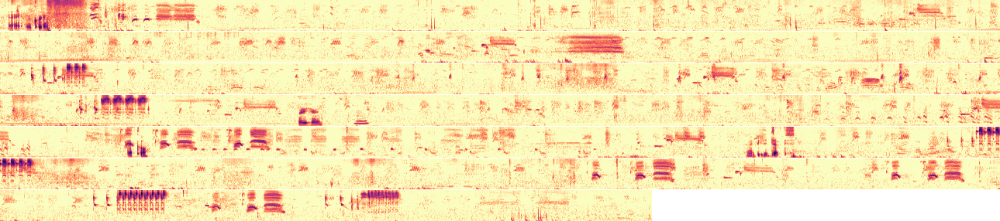

recordings/MAWR marsh wren- yellow headed blackbird- blackbird sp- swallow sp- sierraville: 1 channels, 16 bit, sampled @ 22.05 kHz, 99.777s long


20180608-e46b  2018-06-08T04:13:04  _UNK  101.8s  wilson-s snipe- low trembly -1000hz-


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,MONQ,SOGR,CORA,MAWR,HOOR,CARW,NOMO,SOSP,PHAI,RWBL,EUCD,MODO,WREN,WITU,TUTI
p,0.482,0.141,0.0547,0.0425,0.0302,0.0254,0.024,0.0138,0.0115,0.0105,0.00963,0.00854,0.00798,0.00782,0.00745


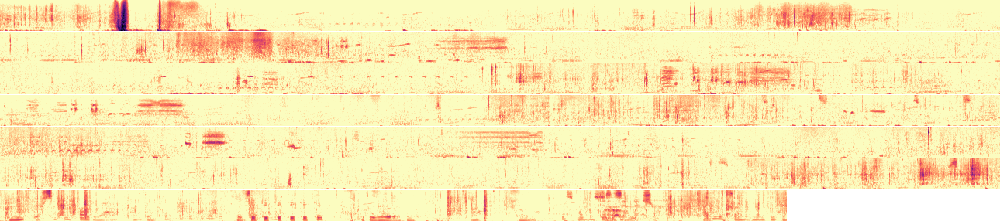

recordings/wilson-s snipe- low trembly -1000hz-: 1 channels, 16 bit, sampled @ 22.05 kHz, 101.798s long


20180608-d281  2018-06-08T04:04:30  AMBI  162.2s  AMBI american bittern- a good clean one at the end- when the bullfrogs went quiet


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,MONQ,CERW,DCCO,ANHU,HOOR,BUOW,BTNW,RWBL,GBHE,COGR,WEBL,MAWR,WCSP,SPTO,CONI
p,0.229,0.158,0.0791,0.0575,0.053,0.0479,0.0461,0.0431,0.0304,0.0186,0.0177,0.0177,0.0154,0.0132,0.0128


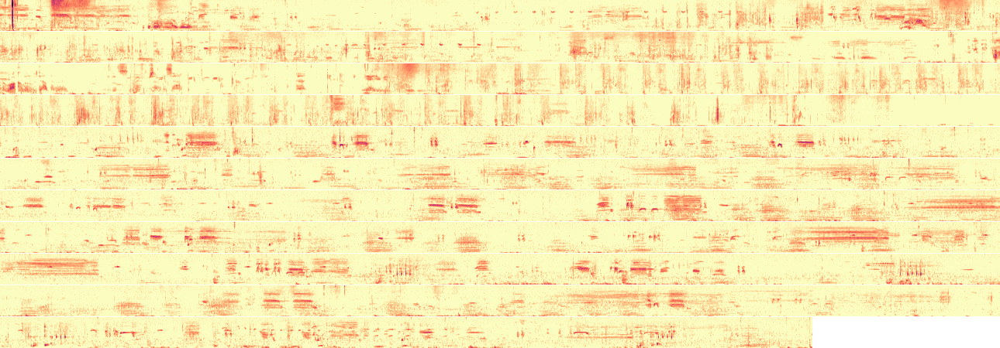

recordings/AMBI american bittern- a good clean one at the end- when the bullfrogs went quiet: 1 channels, 16 bit, sampled @ 22.05 kHz, 162.181s long

In [ ]:
# Inspect recs
for i, rec in enumerate(df_rows(recs
    .sort_values('recorded_at', ascending=False)
    [:20]
)):
    if i > 0: print()
    print(rec_str_line(rec))
    display(rec_probs(rec, search, 15))
    plot_spectro_micro(rec, features, wrap=True,
        # limit_s=60,
    )

,species_true,in_model
20180608-d281,AMBI,False


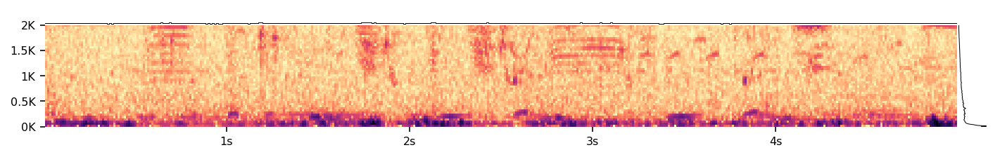

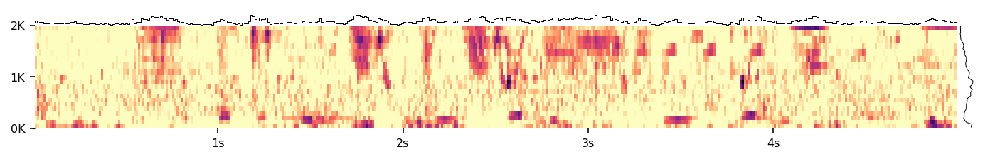

recordings/AMBI american bittern- a good clean one at the end- when the bullfrogs went quiet: 1 channels, 16 bit, sampled @ 22.05 kHz, 5.000s long

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,GREG,SOGR,RODO,MOUQ,BTPI,BUOW,SPTO,TRBL,CASJ,GHOW,COPO,COGR,AMKE,BAEA,RSHA
p,0.117,0.0843,0.065,0.0607,0.0446,0.042,0.0412,0.0302,0.0299,0.0257,0.0174,0.0169,0.0163,0.0159,0.0158


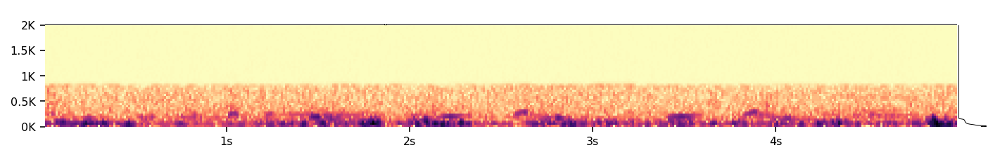

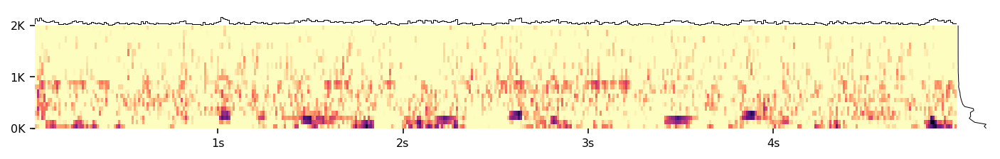

recordings/AMBI american bittern- a good clean one at the end- when the bullfrogs went quiet: 1 channels, 16 bit, sampled @ 22.05 kHz, 5.000s long

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,SOGR,RODO,GHOW,WESO,COPO,BTPI,CORA,CACH,NOHA,CONI,CHSP,OCWA,TUTI,BTYW,BBWA
p,0.485,0.341,0.0746,0.0304,0.00992,0.00639,0.00426,0.00301,0.00287,0.00257,0.00243,0.00201,0.00161,0.00161,0.00157


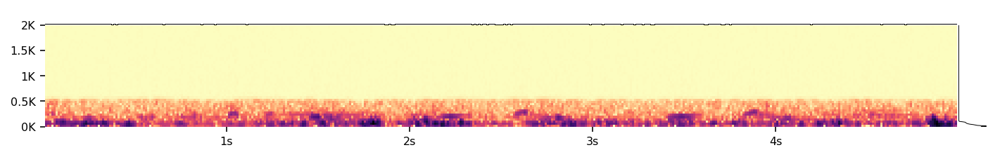

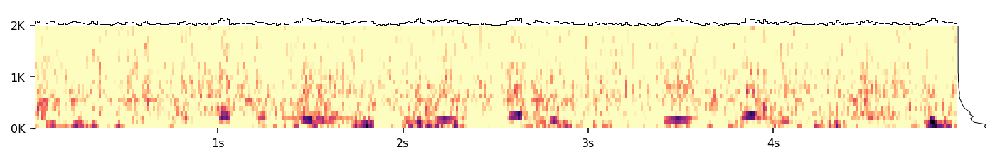

recordings/AMBI american bittern- a good clean one at the end- when the bullfrogs went quiet: 1 channels, 16 bit, sampled @ 22.05 kHz, 5.000s long

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,SOGR,RODO,GHOW,BTPI,WESO,COPO,CONI,CORA,BTNW,NOHA,CACH,TUTI,OCWA,AMRE,CHSP
p,0.437,0.401,0.104,0.0142,0.00713,0.00681,0.00298,0.00182,0.00171,0.00153,0.00149,0.00143,0.0011,0.00107,0.000971


In [ ]:
# Q: Can we isolate the AMBI with a bandpass filter?
#   A: Yep!
#
# TODO bandpass_filter -> clip_below_median_per_freq leaves weird artifacts
#   - Median clipping after zeroing out freq bands just amplifies noise
#   - But maybe it doesn't matter much, as long as it's more like random noise than distracting artifacts?
#   - Defer, but keep in mind for later in case it causes issues
#
plot = lambda rec: rec.spectro.plots(show_audio=True, ylim=(0, 2000))
probs = lambda rec: display(rec_probs(rec, search, 15))
(recs.loc['20180608-d281']  # AMBI
    .pipe(tap, lambda rec: display(search.species_probs_one(rec).pipe(species_probs_meta)))
    .pipe(projection.with_audio, lambda audio: audio[152_200:157_200])
    .pipe(tap, plot, probs)
    .pipe(projection.with_audio, partial(audio_bandpass_filter, hi_hz=800))
    .pipe(tap, plot, probs)
    .pipe(projection.with_audio, partial(audio_bandpass_filter, hi_hz=500))
    .pipe(tap, plot, probs)
);

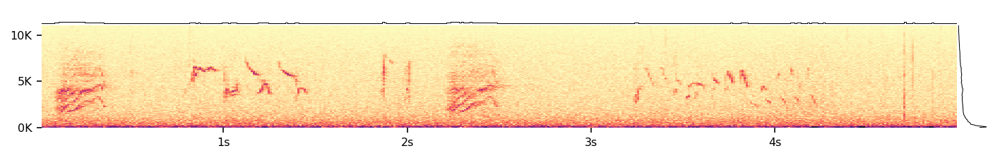

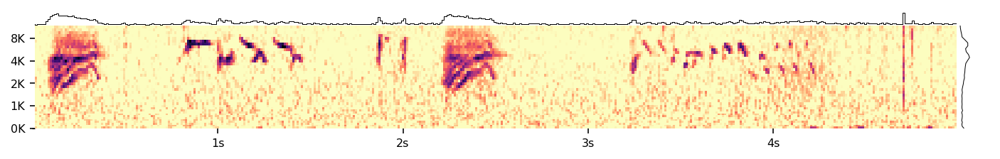

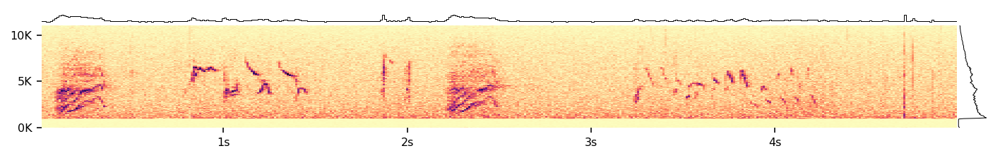

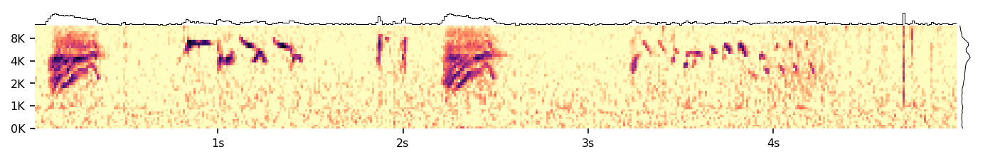

In [ ]:
# Q: Does filtering out low freqs look helpful?
#   A: Nope, not really! We already have a denoising step (in Features._spectro_denoise), so manually filtering is
#      probably useless at best.
(recs.loc['20180805-60c3']  # BEWR - vollmer peak
    .pipe(features.with_audio, lambda audio: audio[10000:15000])
    .pipe(tap, lambda rec: rec.spectro.plots(show_audio=False))
    .pipe(features.with_audio, partial(audio_bandpass_filter, lo_hz=1000))
    .pipe(tap, lambda rec: rec.spectro.plots(show_audio=False))
);